In [55]:
# Standard Imports
from __future__ import print_function
import numpy as np
import pandas as pd
import os
import sys
from collections import defaultdict
from importlib import reload
from bs4 import BeautifulSoup
import requests
import scipy.stats as scs
import time
import seaborn as sns

import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format = 'retina'

# Modeling
# import tensorflow as tf
# from tensorflow import keras
# from tensorflow.keras import datasets, layers, models
# import keras.backend as K
# from tensorflow.keras.constraints import min_max_norm, non_neg
# from sklearn.model_selection import train_test_split
# from sklearn.preprocessing import StandardScaler
# from sklearn.metrics import confusion_matrix
# from sklearn.utils.multiclass import unique_labels
# from sklearn.manifold import TSNE

# Load MongoDB
from pymongo import MongoClient
client = MongoClient()
# Access/Initiate Database
db = client['producer_db']
# Access/Initiate Table
mfcc_tab = db['mfcc']
tab = db['songs']
collection = db.tab
mfcc_collection = db.mfcc_tab

# Authorize Spotify API
import spotipy
from spotipy.oauth2 import SpotifyClientCredentials
client_id = os.environ['SPOTIFY_CLIENT_ID']
client_secret = os.environ['SPOTIFY_CLIENT_SECRET']
client_credentials_manager = SpotifyClientCredentials(client_id=client_id, client_secret=client_secret)
sp = spotipy.Spotify(client_credentials_manager=client_credentials_manager)

# Audio Processing
import librosa
import librosa.display
from IPython.display import Audio
import IPython.display
from scipy.io import wavfile
from pydub import AudioSegment
from src.audio_processing import load_mp3_from_url

# Filter Audio Data Before Calculating MFCCs - Then check for better clustering

In [4]:
# Convert mp3_url to time series data for librosa
mp3_url = 'https://p.scdn.co/mp3-preview/22bf10aff02db272f0a053dff5c0063d729df988?cid=5157426229ce47aea8e1a6c56e231ddf'
y, sr = load_mp3_from_url(mp3_url)

Audio(data = y, rate = sr)

# Band pass filtering

In [37]:
import numpy as np
import pandas as pd
from scipy import signal
import matplotlib.pyplot as plt

def sine_generator(fs, sinefreq, duration):
    T = duration
    nsamples = fs * T
    w = 2. * np.pi * sinefreq
    t_sine = np.linspace(0, T, nsamples, endpoint=False)
    y_sine = np.sin(w * t_sine)
    result = pd.DataFrame({ 
        'data' : y_sine} ,index=t_sine)
    return result

def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='high', analog=False)
    return b, a

def butter_highpass_filter(data, cutoff, fs, order=5):
    b, a = butter_highpass(cutoff, fs, order=order)
    y = signal.filtfilt(b, a, data)
    return y

# Max code
def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='lowpass', analog=False)
    return b, a 

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = signal.filtfilt(b, a, data)
    return y

# Max code
def butter_bandpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='bandpass', analog=False)
    return b, a 

def butter_bandpass_filter(data, cutoff, fs, order=5):
    """
    cutoff must be a 2 element numpy array
    """
    b, a = butter_bandpass(cutoff, fs, order=order)
    y = signal.filtfilt(b, a, data)
    return y


# Max code
def butter_bandstop(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = signal.butter(order, normal_cutoff, btype='bandstop', analog=False)
    return b, a 

def butter_bandstop_filter(data, cutoff, fs, order=5):
    """
    cutoff must be a 2 element numpy array
    """
    b, a = butter_bandstop(cutoff, fs, order=order)
    y = signal.filtfilt(b, a, data)
    return y

# fps = 30
# sine_fq = 10 #Hz
# duration = 10 #seconds
# sine_5Hz = sine_generator(fps,sine_fq,duration)
# sine_fq = 1 #Hz
# duration = 10 #seconds
# sine_1Hz = sine_generator(fps,sine_fq,duration)

# sine = sine_5Hz + sine_1Hz

# filtered_sine = butter_highpass_filter(sine.data,10,fps)

# plt.figure(figsize=(20,10))
# plt.subplot(211)
# plt.plot(range(len(sine)),sine)
# plt.title('generated signal')
# plt.subplot(212)
# plt.plot(range(len(filtered_sine)),filtered_sine)
# plt.title('filtered signal')
# plt.show()

In [133]:
# Apply filters
y_highpass = butter_highpass_filter(y,800,sr)
y_lowpass = butter_lowpass_filter(y,600,sr)
y_bandpass = butter_bandpass_filter(y,np.array([1000,6000]),sr)
y_bandstop = butter_bandstop_filter(y,np.array([600,1000]),sr)

#Print Audio
print ('highpass filter [600Hz]: "Tiny Speakers"')
IPython.display.display(Audio(data = y_highpass, rate = sr))

print ('lowpass filter [600Hz]: "Underwater"')
IPython.display.display(Audio(data = y_lowpass, rate = sr))

print ('bandpass filter [1000Hz, 6000Hz]: "Muzak"')
IPython.display.display(Audio(data = y_bandpass, rate = sr))

print ('bandstop filter [600Hz, 1000Hz] : "Club Remix"')
IPython.display.display(Audio(data = y_bandstop, rate = sr))

highpass filter [600Hz]: "Tiny Speakers"


lowpass filter [600Hz]: "Underwater"


bandpass filter [1000Hz, 6000Hz]: "Muzak"


bandstop filter [600Hz, 1000Hz] : "Club Remix"


# Harmonic-percussive source separation

In [134]:
D = librosa.stft(y)
D_harmonic, D_percussive = librosa.decompose.hpss(D, margin=2)

y_harmonic = librosa.core.istft(D_harmonic)
y_percussive = librosa.core.istft(D_percussive)

print('harmonic filter')
IPython.display.display(Audio(data = y_harmonic, rate = sr))
print('percussive filter')
IPython.display.display(Audio(data = y_percussive, rate = sr))

harmonic filter


percussive filter


In [139]:
y_percussive.shape, y_bandstop.shape

((660992,), (661500,))

In [147]:
print("Max's Choiciest Remix: percussive + bandstop")
Audio(data = (2*y_percussive + y_bandstop[:660992]), rate = sr)

Max's Choiciest Remix: percussive + bandstop


# Reverse beats

In [71]:
>>> _, beat_frames = librosa.beat.beat_track(y=y, sr=sr,
...                                          hop_length=512)

>>> beat_samples = librosa.frames_to_samples(beat_frames)

>>> intervals = librosa.util.frame(beat_samples, frame_length=2,
...                                hop_length=1).T

>>> y_out = librosa.effects.remix(y, intervals[::-1])

print('Rewind beat by beat (beats backward, segments forward)')
IPython.display.display(Audio(y_out, rate = sr))
print('Rickroll fever dream (beats forward, segments backward)')
IPython.display.display(Audio(y_out[::-1], rate = sr))

Rewind beat by beat (beats backward, segments forward)


Rickroll fever dream (beats forward, segments backward)


# Shuffle beats

In [96]:
# Calculate beats
_, beat_frames = librosa.beat.beat_track(y=y, sr=sr, hop_length=512)
beat_samples = librosa.frames_to_samples(beat_frames)
intervals = librosa.util.frame(beat_samples, frame_length=2, hop_length=1).T

# Shuffle intervals
interval_idx = list(range(len(intervals)))
np.random.shuffle(interval_idx)
shuffled_intervals = intervals[interval_idx]

y_shuffle = librosa.effects.remix(y, shuffled_intervals)

print('Shuffled Beats')
IPython.display.display(Audio(y_shuffle, rate = sr))

Shuffled Beats


# Pitch Shift

In [97]:
# shift pitch
y_shift = librosa.effects.pitch_shift(y = y, sr = sr, n_steps=3)

print('Shift up a minor third')
IPython.display.display(Audio(y_shift, rate = sr))

Shift up a minor third


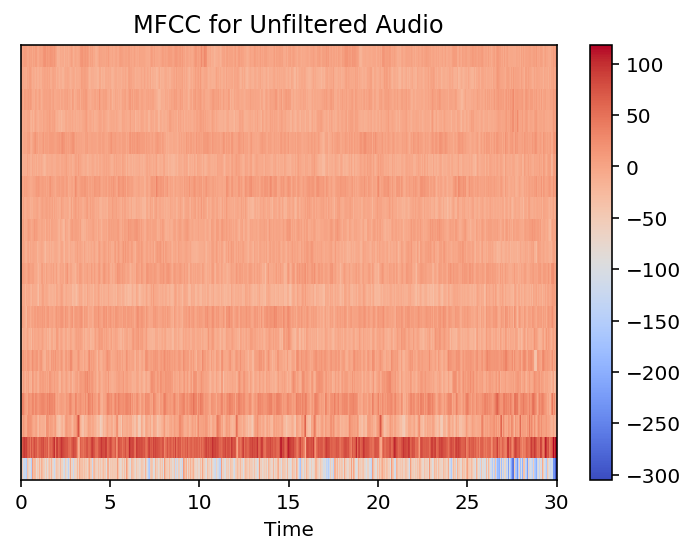

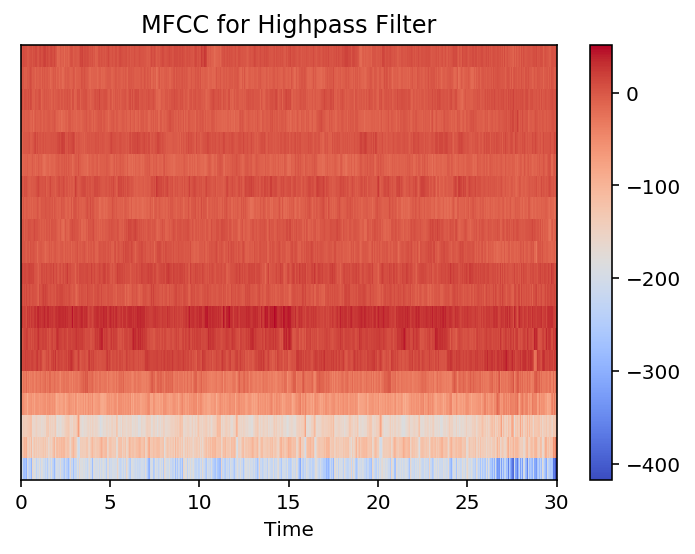

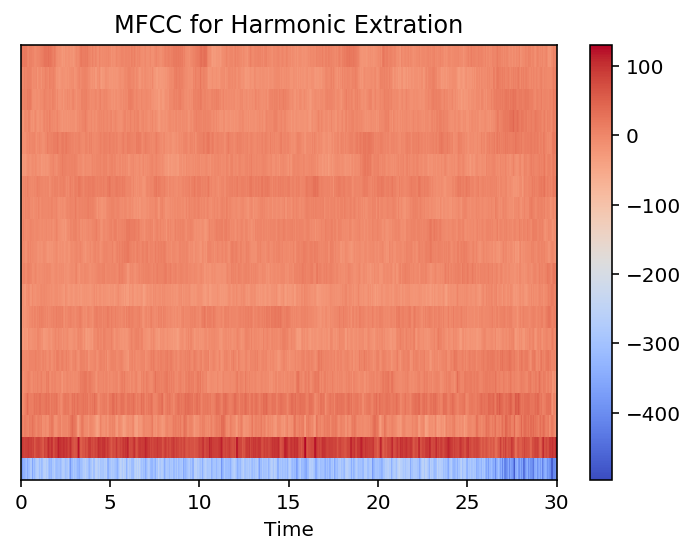

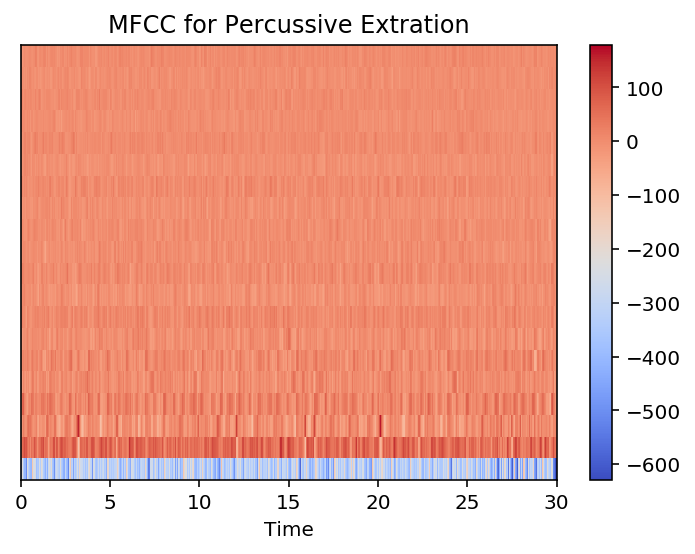

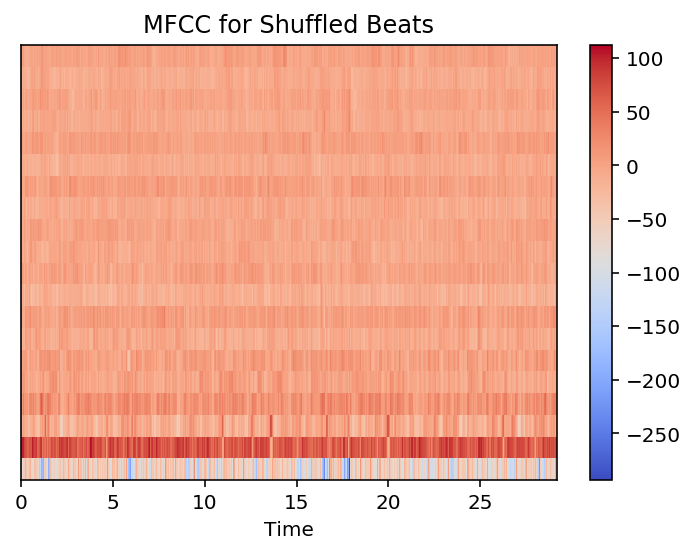

In [112]:
y_mfcc = librosa.feature.mfcc(y)
librosa.display.specshow(y_mfcc, x_axis='time')
plt.title('MFCC for Unfiltered Audio')
plt.colorbar()
plt.show()

y_mfcc_highpass = librosa.feature.mfcc(y_highpass)
librosa.display.specshow(y_mfcc_highpass, x_axis='time')
plt.title('MFCC for Highpass Filter')
plt.colorbar()
plt.show()

y_mfcc_harmonic = librosa.feature.mfcc(y_harmonic)
librosa.display.specshow(y_mfcc_harmonic, x_axis='time')
plt.title('MFCC for Harmonic Extration')
plt.colorbar()
plt.show()

y_mfcc_percussive = librosa.feature.mfcc(y_percussive)
librosa.display.specshow(y_mfcc_percussive, x_axis='time')
plt.title('MFCC for Percussive Extration')
plt.colorbar()
plt.show()

y_mfcc_shuffle = librosa.feature.mfcc(y_shuffle)
librosa.display.specshow(y_mfcc_shuffle, x_axis='time')
plt.title('MFCC for Shuffled Beats')
plt.colorbar()
plt.show()

# Notes on Features

- High pass filters might be good for identity because they contain the higher overtones that dictate timbre
- Harmonic filter might be good because is smoothes over the noise of snares and kicks
    - Note: SOME PRODUCERS ARE KNOWN FOR THEIR SNARES AND KICKS SO MAYBE NOT
- Shuffled beats might be good just in case I'm encoding song structure in the MFCCs

In [113]:
mfcc_collection.find_one().keys()

dict_keys(['_id', 'producer', 'spotify_id', 'MFCC', 'album', 'artist', 'preview_url', 'songs_mongs_id', 'track', 'genres', 'basic_genre'])

# Write a script to add filtered audio to mfcc_collection

In [156]:
def add_filtered_mfcc(collection, filter_list):
    """
    Iterates through each item in a collection. Gets Audio time series from `preview_url`, 
    applies `filter_list`, and add the MFCC array from that filter into the MongoDB.
    
    filter_list: DICT where keys are the desired name of the Mongo key and values are functions:
        filter_list['filter_name'] = <function __main__.<audio_filter(y)>
        and the functions take two arguments: y and sr
    """
    
    for song in collection.find():
        # Load variables from MongoDB
        producer = song['producer']
        spotify_id = song['spotify_id']
        mp3_url = song['preview_url']
        
        # Retrieve Audio File
        y, sr = load_mp3_from_url(mp3_url)
        
        # Process Audio
        for filter_name, filter_function in filter_list.items():
            y_filter = filter_function(y = y, sr = sr)

            # add Audio to mongodb:
            myquery = { "producer": producer,
                        "spotify_id" : spotify_id }

            newvalues = { "$set": {filter_name:y_filter.tolist()}
                        }

            collection.update_one(myquery, newvalues, upsert = False)
            song_count += 1
            print('{} by {}: added'.format(track,artist))


# Define functions

In [153]:
def mfcc_highpass(y, sr):
    y_highpass = butter_highpass_filter(y,800,sr)
    mfcc = librosa.feature.mfcc(y_highpass)
    return mfcc

def mfcc_harmonic(y, sr):
    D = librosa.stft(y)
    D_harmonic, D_percussive = librosa.decompose.hpss(D, margin=2)
    y_harmonic = librosa.core.istft(D_harmonic)
    mfcc = librosa.feature.mfcc(y_harmonic)
    return mfcc

def mfcc_percussive(y, sr):
    D = librosa.stft(y)
    D_harmonic, D_percussive = librosa.decompose.hpss(D, margin=2)
    y_percussive = librosa.core.istft(D_percussive)
    mfcc = mfcc = librosa.feature.mfcc(y_percussive)
    return mfcc
    
def mfcc_shuffle(y, sr):
    # Calculate beats
    _, beat_frames = librosa.beat.beat_track(y=y, sr=sr, hop_length=512)
    beat_samples = librosa.frames_to_samples(beat_frames)
    intervals = librosa.util.frame(beat_samples, frame_length=2, hop_length=1).T

    # Shuffle intervals
    interval_idx = list(range(len(intervals)))
    np.random.shuffle(interval_idx)
    shuffled_intervals = intervals[interval_idx]
    y_shuffle = librosa.effects.remix(y, shuffled_intervals)  
    mfcc = librosa.feature.mfcc(y_shuffle)
    return mfcc

In [154]:
filter_list = {}
filter_list['mfcc_highpass'] = (lambda y, sr: mfcc_highpass(y, sr))
filter_list['mfcc_harmonic'] = (lambda y, sr: mfcc_harmonic(y, sr))
filter_list['mfcc_percussive'] = (lambda y, sr: mfcc_percussive(y,sr))
filter_list['mfcc_shuffle'] = (lambda y, sr: mfcc_shuffle(y,sr))

In [155]:
filter_list

{'mfcc_highpass': <function __main__.<lambda>(y, sr)>,
 'mfcc_harmonic': <function __main__.<lambda>(y, sr)>,
 'mfcc_percussive': <function __main__.<lambda>(y, sr)>,
 'mfcc_shuffle': <function __main__.<lambda>(y, sr)>}